In [76]:
def leer_csv(nombre_archivo):
    resultado = {}
    with open(nombre_archivo, 'r') as archivo:
        lineas = archivo.readlines()
        cabecera = lineas[0].strip().split(';')  # Obtenemos las cabeceras del archivo
        for columna in cabecera:
            resultado[columna] = []
        for linea in lineas[1:]:
            datos = linea.strip().split(';')
            for i, valor in enumerate(datos):
                resultado[cabecera[i]].append(valor)
    return resultado

incidencias_del = leer_csv('delitosAltoImpacto2023a2024.csv')

for columna in incidencias_del.keys():
    print(f"{columna}={len(incidencias_del[columna])}")

ID=28120
ID_CI=28120
FECHA DE INICIO=28120
HORA DE INICIO=28120
CT - INICIO AP=28120
TIPO IMPACTO=28120
DELITO=28120
MODALIDAD - DELITO=28120
FECHA DE LOS HECHOS=28120
HORA DE LOS HECHOS=28120
CALLE 1 HECHOS=28120
CALLE 2 HECHOS=28120
COLONIA HECHOS=28120
ALCALDÍA HECHOS=28120
CT HECHOS=28120
COORD X=28120
COORD Y=28120
OBSERVACIÓN=28120


In [77]:
def ordenar_datos_por_fecha_hora(datos):
    # Extraer listas de fechas y horas
    fechas = datos["FECHA DE LOS HECHOS"]
    horas = datos["HORA DE LOS HECHOS"]
    
    # Combinar fecha y hora y convertir a objetos datetime para poder ordenar
    from datetime import datetime
    # Ajustar el formato para que coincida con tus datos (sin segundos)
    incidencias_del['fechas_horas'] = [datetime.strptime(fecha + ' ' + hora, '%d/%m/%Y %H:%M') for fecha, hora in zip(fechas, horas)]
    
    # Crear una lista de tuplas de todos los datos junto con la fecha y hora combinadas
    registros_combinados = list(zip(incidencias_del['fechas_horas'], *datos.values()))
    
    # Ordenar por la fecha y hora combinada
    registros_combinados.sort()
    
    # Reconstruir el diccionario de datos ordenado
    datos_ordenados = {key: [] for key in datos.keys()}
    for registro in registros_combinados:
        for i, key in enumerate(datos.keys()):
            datos_ordenados[key].append(registro[i+1])  # +1 para omitir el elemento de fecha y hora en la tupla
    
    return datos_ordenados

# Usar la función
incidencias_del = ordenar_datos_por_fecha_hora(incidencias_del)
print(incidencias_del["FECHA DE LOS HECHOS"])
print(incidencias_del["COORD X"])
print(incidencias_del['fechas_horas'])



['01/12/1957', '10/01/1965', '10/03/1966', '21/06/1966', '06/03/1967', '31/12/1969', '31/12/1969', '31/12/1969', '01/01/1974', '01/01/1974', '05/01/1976', '13/08/1976', '01/01/1977', '08/08/1977', '03/09/1977', '01/01/1978', '01/01/1981', '24/12/1981', '01/01/1982', '16/07/1982', '06/06/1983', '16/06/1983', '13/07/1983', '01/01/1985', '25/02/1985', '01/01/1987', '01/01/1987', '01/01/1987', '25/04/1988', '30/05/1988', '01/01/1989', '06/06/1989', '01/01/1990', '29/04/1990', '15/07/1990', '15/10/1990', '30/07/1991', '05/08/1991', '01/10/1991', '12/10/1991', '01/05/1992', '15/05/1993', '15/06/1993', '06/07/1993', '07/07/1994', '07/07/1994', '15/08/1994', '01/02/1995', '04/04/1995', '06/06/1995', '24/10/1995', '01/01/1996', '10/03/1996', '05/05/1996', '27/06/1996', '20/10/1997', '24/12/1997', '01/01/1998', '30/03/1998', '01/05/1998', '20/06/1998', '15/11/1998', '01/01/1999', '01/01/1999', '10/01/1999', '11/11/1999', '01/02/2000', '27/11/2000', '05/12/2000', '10/04/2001', '05/05/2001', '15/0

In [78]:
def manual_csv_parser(line):
    in_quotes = False
    field = ''
    fields = []
    
    for char in line:
        if char == '"' and (not field or field[-1] != '\\'):  # Detecta una comilla que no está escapada
            in_quotes = not in_quotes  # Cambia el estado de estar o no dentro de comillas
        elif char == ',' and not in_quotes:  # Si encuentra una coma fuera de comillas, es un delimitador de campo
            fields.append(field.strip())
            field = ''
        else:
            field += char
    
    if field:  # Agregar el último campo
        fields.append(field.strip())
    
    return fields

# Función para convertir la cadena de geo_shape a una lista de puntos
def parse_geo_shape(geo_shape):
    # Eliminar los caracteres iniciales y finales para quedarse solo con la parte de las coordenadas
    start = geo_shape.find('[[')
    end = geo_shape.rfind(']]')
    coords_text = geo_shape[start+2:end]

    # Dividir en pares de coordenadas y limpiar los corchetes
    coords_pairs = coords_text.split('], [')
    coords = []
    for pair in coords_pairs:
        pair = pair.strip('[]')  # Elimina los corchetes sobrantes de cada par
        x, y = map(float, pair.split(', '))
        coords.append((x, y))
    return coords


# Función para convertir la cadena geo_point_2d en una tupla
def parse_geo_point(geo_point):
    x, y = map(float, geo_point.split(","))
    return (x, y)

def leer_cuadrantes(file_path):

    # Diccionario para almacenar los datos
    data_dict = {}

    # Abrir y leer el archivo
    with open(file_path, mode='r', encoding='utf-8') as file:
        headers = manual_csv_parser(file.readline())  # Leer y parsear los nombres de columnas
        for line in file:
            values = manual_csv_parser(line)  # Leer y parsear cada línea usando la nueva función
            row_id = int(values[0])
            # Crear un diccionario para cada fila usando los índices correctos
            row_dict = {
                'no_region': int(values[1]),
                'no_cuadran': int(values[2]),
                'zona': values[3],
                'geo_shape': parse_geo_shape(values[4]),
                'geo_point_2d': parse_geo_point(values[5]),
                'alcaldia': values[6],
                'sector': values[7],
                'clave_sect': int(values[8])
            }
            # Agregar el diccionario de la fila al diccionario principal usando el ID como clave
            data_dict[row_id] = row_dict
    
    return data_dict
            

# Path al archivo CSV
cuadrantes = leer_cuadrantes('cuadrantes.csv')
print(cuadrantes[0])


{'no_region': 1, 'no_cuadran': 8, 'zona': 'PONIENTE', 'geo_shape': [(-99.2138451738739, 19.32244324294661), (-99.21396917387389, 19.323856242946608), (-99.21395417387389, 19.324748242946608), (-99.21401917387391, 19.325595242946605), (-99.21354517387388, 19.325952242946606), (-99.2132901738739, 19.326212242946607), (-99.21303517387389, 19.326493242946608), (-99.21182517387389, 19.32819124294661), (-99.21083417387389, 19.330144242946606), (-99.21044917387388, 19.330809242946607), (-99.2103361738739, 19.331076242946605), (-99.2097131738739, 19.33125324294661), (-99.2090491738739, 19.331462242946607), (-99.20832917387389, 19.331708242946604), (-99.2079411738739, 19.331870242946607), (-99.20771617387389, 19.33198224294661), (-99.20763917387389, 19.33202424294661), (-99.2075601738739, 19.332051242946605), (-99.2074471738739, 19.332078242946608), (-99.20722917387388, 19.332078242946608), (-99.20685617387389, 19.332063242946607), (-99.2064521738739, 19.332010242946605), (-99.2064911738739, 19

In [79]:
def calcular_centroide(vertices):
    x_list = [vertex[0] for vertex in vertices]
    y_list = [vertex[1] for vertex in vertices]
    longitud = len(vertices)
    x_centroide = sum(x_list) / longitud
    y_centroide = sum(y_list) / longitud
    return (x_centroide, y_centroide)

In [80]:
for id_cuadrante, cuadrante in cuadrantes.items():
    centroide = calcular_centroide(cuadrante['geo_shape'])
    cuadrante['centroide'] = centroide
print(cuadrantes[0])

{'no_region': 1, 'no_cuadran': 8, 'zona': 'PONIENTE', 'geo_shape': [(-99.2138451738739, 19.32244324294661), (-99.21396917387389, 19.323856242946608), (-99.21395417387389, 19.324748242946608), (-99.21401917387391, 19.325595242946605), (-99.21354517387388, 19.325952242946606), (-99.2132901738739, 19.326212242946607), (-99.21303517387389, 19.326493242946608), (-99.21182517387389, 19.32819124294661), (-99.21083417387389, 19.330144242946606), (-99.21044917387388, 19.330809242946607), (-99.2103361738739, 19.331076242946605), (-99.2097131738739, 19.33125324294661), (-99.2090491738739, 19.331462242946607), (-99.20832917387389, 19.331708242946604), (-99.2079411738739, 19.331870242946607), (-99.20771617387389, 19.33198224294661), (-99.20763917387389, 19.33202424294661), (-99.2075601738739, 19.332051242946605), (-99.2074471738739, 19.332078242946608), (-99.20722917387388, 19.332078242946608), (-99.20685617387389, 19.332063242946607), (-99.2064521738739, 19.332010242946605), (-99.2064911738739, 19

In [81]:
sector_alcaldias = {}
for cuadrante in cuadrantes.keys():
    if cuadrantes[cuadrante]["alcaldia"] not in sector_alcaldias:
        sector_alcaldias[cuadrantes[cuadrante]["alcaldia"]] = cuadrantes[cuadrante]["geo_point_2d"]
print(sector_alcaldias)

{'ALVARO OBREGON': (19.3279411421, -99.2101175866), 'CUAUHTEMOC': (19.4587306491, -99.1427404298), 'GUSTAVO A MADERO': (19.575635456, -99.1303693591), 'VENUSTIANO CARRANZA': (19.409182931, -99.1078418053), 'IZTACALCO': (19.3838323154, -99.1166923947), 'COYOACAN': (19.3414291544, -99.1843601487), 'IZTAPALAPA': (19.3847541847, -99.0807925946), 'BENITO JUAREZ': (19.3935607366, -99.158618101), 'TLALPAN': (19.3020035125, -99.1336012245), 'MIGUEL HIDALGO': (19.4614999353, -99.1946989277), 'AZCAPOTZALCO': (19.5059745842, -99.2020828973), 'MILPA ALTA': (19.1935097215, -99.0930538675), 'TLAHUAC': (19.2257291996, -98.9611125991), 'XOCHIMILCO': (19.2687743268, -99.1364145805), 'MAGDALENA CONTRERAS': (19.3248560963, -99.2325579452), 'CUAJIMALPA': (19.3276280144, -99.3287484795)}


In [82]:
for i in range(0, len(incidencias_del['ALCALDÍA HECHOS'])):
    if incidencias_del['ALCALDÍA HECHOS'][i] == "LA MAGDALENA CONTRERAS":
        incidencias_del['ALCALDÍA HECHOS'][i] = "MAGDALENA CONTRERAS"
    if incidencias_del['ALCALDÍA HECHOS'][i] == "CUAJIMALPA DE MORELOS":
        incidencias_del['ALCALDÍA HECHOS'][i] = "CUAJIMALPA"

In [83]:
for ind_reg in range(0, len(incidencias_del["COORD X"])):
    if incidencias_del["COORD X"][ind_reg] == "SIN REGISTRO" and incidencias_del["ALCALDÍA HECHOS"][ind_reg] != "SIN REGISTRO":
        incidencias_del["COORD X"][ind_reg] = sector_alcaldias[incidencias_del["ALCALDÍA HECHOS"][ind_reg]][0]
        incidencias_del["COORD Y"][ind_reg] = sector_alcaldias[incidencias_del["ALCALDÍA HECHOS"][ind_reg]][1]
    elif incidencias_del["ALCALDÍA HECHOS"][ind_reg] == "SIN REGISTRO":
        for clave in incidencias_del.keys():
            incidencias_del[clave][ind_reg] = "@"


In [84]:
for columna in incidencias_del.keys():
    while "@" in incidencias_del[columna]:
        incidencias_del[columna].remove("@")

for columna in incidencias_del.keys():
    print(f"{columna}={len(incidencias_del[columna])}")

ID=27029
ID_CI=27029
FECHA DE INICIO=27029
HORA DE INICIO=27029
CT - INICIO AP=27029
TIPO IMPACTO=27029
DELITO=27029
MODALIDAD - DELITO=27029
FECHA DE LOS HECHOS=27029
HORA DE LOS HECHOS=27029
CALLE 1 HECHOS=27029
CALLE 2 HECHOS=27029
COLONIA HECHOS=27029
ALCALDÍA HECHOS=27029
CT HECHOS=27029
COORD X=27029
COORD Y=27029
OBSERVACIÓN=27029
fechas_horas=27029


In [85]:
def filtrar_cuadrantes_por_alcaldia(cuadrantes, alcaldias_interes):
    cuadrantes_filtrados = {}
    for id_cuadrante, datos in cuadrantes.items():
        if datos['alcaldia'] in alcaldias_interes:
            cuadrantes_filtrados[id_cuadrante] = datos
    return cuadrantes_filtrados

In [86]:
def calc_distancia_euclidiana(x, y, centroide):
    cx, cy = centroide
    distancia = ((x - cx) ** 2 + (y - cy) ** 2)**(1/2)
    return distancia

In [87]:
print(incidencias_del["COORD X"])

['-99.1513615', '-99.21251212', '-99.15519753', '-99.06842887', '-99.20134194', '-99.07673478', '-99.1117837', '-99.06990521', '-99.16952408', '-99.25530581', '-99.1685358', '-99.08448355', '-99.17093966', 19.4587306491, '-99.10938455', '-99.23237108', '-99.11950193', '-99.17970177', '-99.1613958', '-99.12194073', '-99.16989326', '-99.13921209', '-99.01879907', '-99.11168262', 19.4587306491, '-99.15013772', '-99.11007645', '-99.12148744', '-99.02377456', '-99.13535289', '-99.23194081', '-99.08107728', '-99.06396843', '-99.14582033', '-99.20213208', '-99.05916017', '-99.06392857', '-99.12664331', '-99.10190659', '-99.1156822', '-98.96088548', '-99.13448274', '-99.09146737', '-99.07531567', 19.3838323154, 19.4587306491, '-99.13087383', '-99.16355051', '-99.06891337', 19.4587306491, '-99.11206092', '-99.25286874', '-99.13874164', '-99.1075093', '-99.100319', '-99.05129582', '-99.18892926', '-99.15136477', '-99.17234436', '-99.0471594', '-99.04167406', '-99.10042293', '-99.03240304', '-99.

In [88]:
def llave_min_valor(diccionario):
    #print(diccionario)
    # Usamos max() con una función lambda para obtener la clave correspondiente al valor máximo
    mix_valor = min(diccionario.values())
    # Buscamos la clave que corresponde al valor máximo
    for clave, valor in diccionario.items():
        if valor == mix_valor:
            return clave

In [89]:
def punto_dentro_poligono(x, y, puntos_poligono, tolerancia=1e-10):
    n = len(puntos_poligono)
    dentro = None
    p1x, p1y = puntos_poligono[0]
    
    # Verificar si el punto es uno de los vértices
    if (x, y) in puntos_poligono:
        return True

    for i in range(n + 1):
        p2x, p2y = puntos_poligono[i % n]
        if y > min(p1y, p2y) - tolerancia and y <= max(p1y, p2y) + tolerancia:
            if x <= max(p1x, p2x) + tolerancia:
                if p1y != p2y:
                    xinters = (y - p1y) * (p2x - p1x) / (p2y - p1y) + p1x
                    if abs(x - xinters) <= tolerancia:
                        return True
                if p1x == p2x or x <= xinters:
                    dentro = not dentro
        p1x, p1y = p2x, p2y
    return dentro

In [90]:
cambios = 0
for i in range(0, len(incidencias_del['COORD X'])):
    if float(incidencias_del['COORD X'][i]) > 0:
        cambios += 1
        aux_x = float(incidencias_del['COORD X'][i])
        aux_y = float(incidencias_del['COORD Y'][i])
        incidencias_del['COORD X'][i] = aux_y
        incidencias_del['COORD Y'][i] = aux_x
print(cambios)

783


In [91]:
"""incidencias_del["CUADRANTE"] = []
incidencias_del["SECTOR"] = []

for x, y, alcaldia in zip(incidencias_del['COORD X'], incidencias_del['COORD Y'], incidencias_del['ALCALDÍA HECHOS']):
    cuadrantes_candidatos = filtrar_cuadrantes_por_alcaldia(cuadrantes, (alcaldia,))
    for cuadrante_c in cuadrantes_candidatos.keys():
        cuadrantes_candidatos[cuadrante_c] = calc_distancia_euclidiana(float(x), float(y), cuadrantes[cuadrante_c]['centroide'])

    incidencias_del['CUADRANTE'].append(llave_min_valor(cuadrantes_candidatos))
    incidencias_del['SECTOR'].append(cuadrantes[incidencias_del['CUADRANTE'][-1]]['sector'])

print(incidencias_del['CUADRANTE'])
print(len(incidencias_del['CUADRANTE']))
    """

'incidencias_del["CUADRANTE"] = []\nincidencias_del["SECTOR"] = []\n\nfor x, y, alcaldia in zip(incidencias_del[\'COORD X\'], incidencias_del[\'COORD Y\'], incidencias_del[\'ALCALDÍA HECHOS\']):\n    cuadrantes_candidatos = filtrar_cuadrantes_por_alcaldia(cuadrantes, (alcaldia,))\n    for cuadrante_c in cuadrantes_candidatos.keys():\n        cuadrantes_candidatos[cuadrante_c] = calc_distancia_euclidiana(float(x), float(y), cuadrantes[cuadrante_c][\'centroide\'])\n\n    incidencias_del[\'CUADRANTE\'].append(llave_min_valor(cuadrantes_candidatos))\n    incidencias_del[\'SECTOR\'].append(cuadrantes[incidencias_del[\'CUADRANTE\'][-1]][\'sector\'])\n\nprint(incidencias_del[\'CUADRANTE\'])\nprint(len(incidencias_del[\'CUADRANTE\']))\n    '

In [92]:
incidencias_del["CUADRANTE"] = []
incidencias_del["SECTOR"] = []
euclidian = 0

for x, y, alcaldia in zip(incidencias_del['COORD X'], incidencias_del['COORD Y'], incidencias_del['ALCALDÍA HECHOS']):
    cuadrantes_candidatos = filtrar_cuadrantes_por_alcaldia(cuadrantes, (alcaldia,))
    cuadrante = None
    for cuadrante_c in cuadrantes_candidatos.keys():
        #cuadrantes_candidatos[cuadrante_c] = calc_distancia_euclidiana(float(x), float(y), cuadrantes[cuadrante_c]['centroide'])
        cuadrante = punto_dentro_poligono(float(x), float(y), cuadrantes_candidatos[cuadrante_c]['geo_shape'])
        cuadrantes_candidatos[cuadrante_c] = calc_distancia_euclidiana(float(x), float(y), cuadrantes[cuadrante_c]['centroide'])
        if cuadrante == True:
            cuadrante = cuadrante_c
            break
        
    if cuadrante == None:
        euclidian +=1
        incidencias_del['CUADRANTE'].append(llave_min_valor(cuadrantes_candidatos))
    else:
        incidencias_del['CUADRANTE'].append(cuadrante)
    incidencias_del['SECTOR'].append(cuadrantes[incidencias_del['CUADRANTE'][-1]]['sector'])

print(f"euclidian = {euclidian}")
print(incidencias_del['CUADRANTE'])
print(len(incidencias_del['CUADRANTE']))

euclidian = 246
[798, 255, 212, 510, 723, 341, 21, 817, 615, 275, 615, 604, 701, 2, 211, 255, 379, 665, 616, 217, 373, 808, 207, 355, 2, 317, 213, 310, 475, 837, 277, 413, 131, 458, 492, 52, 131, 278, 24, 381, 132, 547, 47, 55, 27, 2, 593, 280, 139, 2, 34, 803, 434, 715, 325, 485, 400, 137, 137, 250, 819, 324, 144, 816, 17, 2, 275, 69, 839, 243, 379, 403, 723, 142, 803, 515, 37, 777, 725, 833, 417, 431, 418, 568, 515, 154, 136, 537, 587, 45, 151, 666, 544, 746, 524, 386, 250, 515, 811, 24, 26, 515, 834, 274, 435, 832, 691, 181, 716, 357, 125, 77, 200, 2, 2, 237, 2, 502, 117, 625, 158, 414, 357, 530, 2, 459, 251, 117, 624, 783, 30, 2, 2, 582, 17, 720, 816, 27, 591, 834, 693, 592, 2, 514, 468, 274, 328, 2, 535, 256, 233, 194, 728, 315, 222, 772, 237, 2, 446, 210, 540, 100, 460, 138, 191, 54, 220, 2, 2, 2, 803, 789, 65, 739, 479, 2, 746, 228, 799, 652, 126, 186, 152, 121, 143, 704, 537, 537, 332, 788, 447, 757, 20, 771, 210, 274, 122, 165, 151, 189, 125, 2, 709, 2, 442, 617, 2, 768, 702, 

In [93]:
"""claves_alcaldía = {'AZCAPOTZALCO': 'AZ', 'ALVARO OBREGON': 'AO', 'BENITO JUAREZ':'BJ', 'COYOACAN':'COY', 'CUAUHTEMOC': 'CUH', 'IZTACALCO':'IZC', 'IZTAPALAPA': 'IZP', 'GUSTAVO A MADERO':'GAM', 'CUAJIMALPA':'CJ', 'TLAHUAC':'TLH', 'MAGDALENA CONTRERAS':'MC', 'MILPA ALTA':'MIL', 'MIGUEL HIDALGO': 'MH', 'TLALPAN':'TLP', 'VENUSTIANO CARRANZA': 'VC', 'XOCHIMILCO':'XO'}
print(len(claves_alcaldía))"""

"claves_alcaldía = {'AZCAPOTZALCO': 'AZ', 'ALVARO OBREGON': 'AO', 'BENITO JUAREZ':'BJ', 'COYOACAN':'COY', 'CUAUHTEMOC': 'CUH', 'IZTACALCO':'IZC', 'IZTAPALAPA': 'IZP', 'GUSTAVO A MADERO':'GAM', 'CUAJIMALPA':'CJ', 'TLAHUAC':'TLH', 'MAGDALENA CONTRERAS':'MC', 'MILPA ALTA':'MIL', 'MIGUEL HIDALGO': 'MH', 'TLALPAN':'TLP', 'VENUSTIANO CARRANZA': 'VC', 'XOCHIMILCO':'XO'}\nprint(len(claves_alcaldía))"

In [94]:
"""claves = []
for i in incidencias_del['CT HECHOS']:
    if i not in claves:
        claves.append(i)
print(len(claves))"""

"claves = []\nfor i in incidencias_del['CT HECHOS']:\n    if i not in claves:\n        claves.append(i)\nprint(len(claves))"

In [95]:
"""cuadrantes = {f"{claves_alcaldía[valor['alcaldia']]}-{valor['no_cuadran']}": valor for _, valor in cuadrantes.items()}
print(cuadrantes['AO-8'])
print(len(cuadrantes))"""

'cuadrantes = {f"{claves_alcaldía[valor[\'alcaldia\']]}-{valor[\'no_cuadran\']}": valor for _, valor in cuadrantes.items()}\nprint(cuadrantes[\'AO-8\'])\nprint(len(cuadrantes))'

In [96]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import HeatMap
from shapely.geometry import Polygon

# Cargar los datos
data = pd.read_csv('delitosAltoImpacto2023a2024.csv', delimiter=';')

# Limpieza de los datos: convertir "SIN REGISTRO" a NaN y luego eliminar esas filas
data['COORD X'] = pd.to_numeric(data['COORD X'], errors='coerce')
data['COORD Y'] = pd.to_numeric(data['COORD Y'], errors='coerce')
data = data.dropna(subset=['COORD X', 'COORD Y'])

# Convertir a geodataframe
gdf = gpd.GeoDataFrame(
    data, 
    geometry=gpd.points_from_xy(data['COORD X'], data['COORD Y']),
    crs="EPSG:4326"
)

# Crear el mapa centrado en un punto medio de las coordenadas (ajustar según sea necesario)
mapa = folium.Map(location=[gdf.geometry.y.mean(), gdf.geometry.x.mean()], zoom_start=12)


# Agregar el mapa de calor
HeatMap(data=gdf[['COORD Y', 'COORD X']].values, radius=15).add_to(mapa)

# Guardar el mapa en un archivo HTML
mapa


In [97]:
data = pd.DataFrame(incidencias_del)

# Limpiar los datos: eliminar filas con coordenadas nulas
data = data.dropna(subset=['COORD X', 'COORD Y'])

# Convertir a geodataframe
gdf = gpd.GeoDataFrame(
    data, 
    geometry=gpd.points_from_xy(data['COORD X'], data['COORD Y']),
    crs="EPSG:4326"
)

# Crear el mapa centrado en un punto medio de las coordenadas (ajustar según sea necesario)
mapa = folium.Map(location=[gdf.geometry.y.mean(), gdf.geometry.x.mean()], zoom_start=12)

for cuadrante_id, cuadrante_data in cuadrantes.items():
    polygon = Polygon(cuadrante_data['geo_shape'])
    polygon_coords = [[point[1], point[0]] for point in polygon.exterior.coords]
    folium.Polygon(locations=polygon_coords,
                   tooltip=str(cuadrante_id),
                   color='blue',
                   fill=False).add_to(mapa)


# Agregar el mapa de calor
HeatMap(data=gdf[['COORD Y', 'COORD X']].values, radius=15).add_to(mapa)

# Guardar el mapa en un archivo HTML
mapa


In [98]:
# Función para convertir coordenadas DMS a coordenadas decimales directamente
def convert_dms_to_decimal(coordinates):
    # Se asume que las coordenadas están en el formato '19.38968° N, 99.09728° O'
    # Primero se separan las coordenadas de latitud y longitud
    lat, lon = coordinates.split(', ')
    
    # Se separan los grados de la dirección (N/S/E/W)
    lat_deg, lat_dir = lat.split(' ')
    lon_deg, lon_dir = lon.split(' ')
    
    # Se convierte a decimal
    lat_decimal = float(lat_deg) * (-1 if lat_dir == 'S' else 1)
    lon_decimal = float(lon_deg) * (-1 if lon_dir == 'O' else 1)
    
    return lon_decimal, lat_decimal


def encuentra_cuadrante(x, y, cuadrantes):
    for clave, datos in cuadrantes.items():
        if punto_dentro_poligono(x, y, datos['geo_shape']):
            return clave
    return None

def delitos_en_cuadrante(clave_cuadrante, incidencias):
    resultados = []
    indices = [i for i, v in enumerate(incidencias['CUADRANTE']) if v == clave_cuadrante]
    for idx in indices:
        resultados.append({key: incidencias[key][idx] for key in incidencias})
    return resultados

# Asumo que cuadrantes_dict y incidencias_del ya están definidos

# Entrada de usuario
#x_usuario = input("Introduce tu coordenada X: ")
x_usuario = "19.38966 N"
#y_usuario = input("Introduce tu coordenada Y: ")
y_usuario = "99.09729 O"

x_usuario, y_usuario = convert_dms_to_decimal(f"{x_usuario}, {y_usuario}")
print(x_usuario, y_usuario)


# Encuentra el cuadrante
cuadrante_usuario = encuentra_cuadrante(x_usuario, y_usuario, cuadrantes)
if cuadrante_usuario:
    print(f"Estás en el cuadrante {cuadrante_usuario}")
    # Obtén los delitos en ese cuadrante
    delitos = delitos_en_cuadrante(cuadrante_usuario, incidencias_del)
    if delitos:
        print("Delitos registrados en tu cuadrante:")
        for delito in delitos:
            print(delito)
    else:
        print("No se registraron delitos en tu cuadrante.")
else:
    print("No se pudo determinar el cuadrante para tus coordenadas.")

-99.09729 19.38966
Estás en el cuadrante 716
Delitos registrados en tu cuadrante:
{'ID': '13613', 'ID_CI': '9511438', 'FECHA DE INICIO': '2023-07-18', 'HORA DE INICIO': '16:35', 'CT - INICIO AP': 'FDS-7', 'TIPO IMPACTO': 'ALTO IMPACTO', 'DELITO': 'VIOLACIÓN', 'MODALIDAD - DELITO': 'VIOLACION EQUIPARADA', 'FECHA DE LOS HECHOS': '15/06/2007', 'HORA DE LOS HECHOS': '20:00', 'CALLE 1 HECHOS': 'SUR 141', 'CALLE 2 HECHOS': 'SIN REGISTRO', 'COLONIA HECHOS': 'AMPLIACIÓN GABRIEL RAMOS MILLÁN', 'ALCALDÍA HECHOS': 'IZTACALCO', 'CT HECHOS': 'IZC-2', 'COORD X': '-99.09866966', 'COORD Y': '19.38866125', 'OBSERVACIÓN': '* LAS COORDENADAS QUE SE MUESTRAN NO CORRESPONDEN DE MANERA EXACTA AL LUGAR DE LOS HECHOS, SINO QUE LA UBICACIÓN ES APROXIMADA, MANTENIENDO LA SIGNIFICANCIA GEOESTADÍSTICA.', 'fechas_horas': datetime.datetime(2007, 6, 15, 20, 0), 'CUADRANTE': 716, 'SECTOR': 'TLACOTAL'}
{'ID': '4995', 'ID_CI': '9414603', 'FECHA DE INICIO': '2023-03-13', 'HORA DE INICIO': '19:11', 'CT - INICIO AP': 'AEJ

In [99]:
def calcula_centroide_cuadrante(puntos_poligono):
    n = len(puntos_poligono)
    if n < 3:
        raise ValueError("Un polígono debe tener al menos tres puntos")

    area = 0
    cx = 0
    cy = 0
    for i in range(n):
        x0, y0 = puntos_poligono[i]
        x1, y1 = puntos_poligono[(i + 1) % n]
        factor = (x0 * y1 - x1 * y0)
        area += factor
        cx += (x0 + x1) * factor
        cy += (y0 + y1) * factor

    area /= 2
    if area == 0:
        raise ValueError("Área del polígono es cero, revisa los puntos del polígono")

    cx /= (6 * area)
    cy /= (6 * area)

    return (cx, cy)

def crea_mapa_usuario(cuadrante, delitos, centroide):
    # Crear un mapa centrado en el centroide del cuadrante
    mapa = folium.Map(location=centroide, zoom_start=15)

    # Dibujar el polígono del cuadrante
    folium.Polygon(
        locations=cuadrante['geo_shape'],
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.2,
        weight=2
    ).add_to(mapa)

    # Colocar marcadores para cada delito
    for delito in delitos:
        folium.Marker(
            location=[delito['COORD Y'], delito['COORD X']],
            popup=f"Delito: {delito['DELITO']}<br>Fecha: {delito['FECHA DE LOS HECHOS']}",
            icon=folium.Icon(color='red', icon='info-sign')
        ).add_to(mapa)

    return mapa

if cuadrante_usuario:
    cuadrante_datos = cuadrantes[cuadrante_usuario]

    geo_shape_incorrecto = cuadrante_datos['geo_shape']

    # Invierte las coordenadas para obtener el formato correcto [latitud, longitud]
    geo_shape_correcto = [(lon, lat) for lat, lon in geo_shape_incorrecto]

    # Ahora 'geo_shape_correcto' contiene las coordenadas en el orden correcto
    cuadrante_datos['geo_shape'] = geo_shape_correcto

    centroide = calcula_centroide_cuadrante(cuadrante_datos['geo_shape'])

    print(cuadrante_datos)
    print(delitos)
    print(centroide)

    # Crear el mapa
    mapa = crea_mapa_usuario(cuadrante_datos, delitos, centroide)

    # Guardar el mapa en un archivo HTML
    mapa.save('mapa_delitos.html')
    display(mapa)

    print("El mapa ha sido creado y guardado como 'mapa_delitos.html'.")
else:
    print("No se pudo determinar el cuadrante para tus coordenadas.")


{'no_region': 2, 'no_cuadran': 11, 'zona': 'NORTE', 'geo_shape': [(19.390666242946608, -99.0883891738739), (19.39036924294661, -99.08858417387388), (19.387810242946603, -99.09024617387391), (19.383991242946607, -99.0927271738739), (19.385715242946606, -99.1003061738739), (19.388826242946607, -99.09986717387389), (19.39110624294661, -99.09956417387389), (19.39068024294661, -99.0954091738739), (19.390502242946607, -99.09331217387388), (19.390295242946607, -99.0911671738739), (19.390264242946607, -99.09048517387389), (19.391381242946608, -99.08999317387389), (19.39087824294661, -99.08893417387391), (19.390666242946608, -99.0883891738739)], 'geo_point_2d': (19.3879153291, -99.0949751574), 'alcaldia': 'IZTACALCO', 'sector': 'TLACOTAL', 'clave_sect': 3, 'centroide': (-99.09266960244531, 19.38951088580375)}
[{'ID': '13613', 'ID_CI': '9511438', 'FECHA DE INICIO': '2023-07-18', 'HORA DE INICIO': '16:35', 'CT - INICIO AP': 'FDS-7', 'TIPO IMPACTO': 'ALTO IMPACTO', 'DELITO': 'VIOLACIÓN', 'MODALIDA

El mapa ha sido creado y guardado como 'mapa_delitos.html'.


In [100]:
incidencias_del["COORD X"] = [float(coordenada) for coordenada in incidencias_del["COORD X"]]
incidencias_del["COORD Y"] = [float(coordenada) for coordenada in incidencias_del["COORD Y"]]

k=6k=4k=3k=7



k=2k=1
k=5

k=8
k=9
k=10
k=11
k=12
k=13
k=14
k=15
k=16
k=17
k=18
k=19


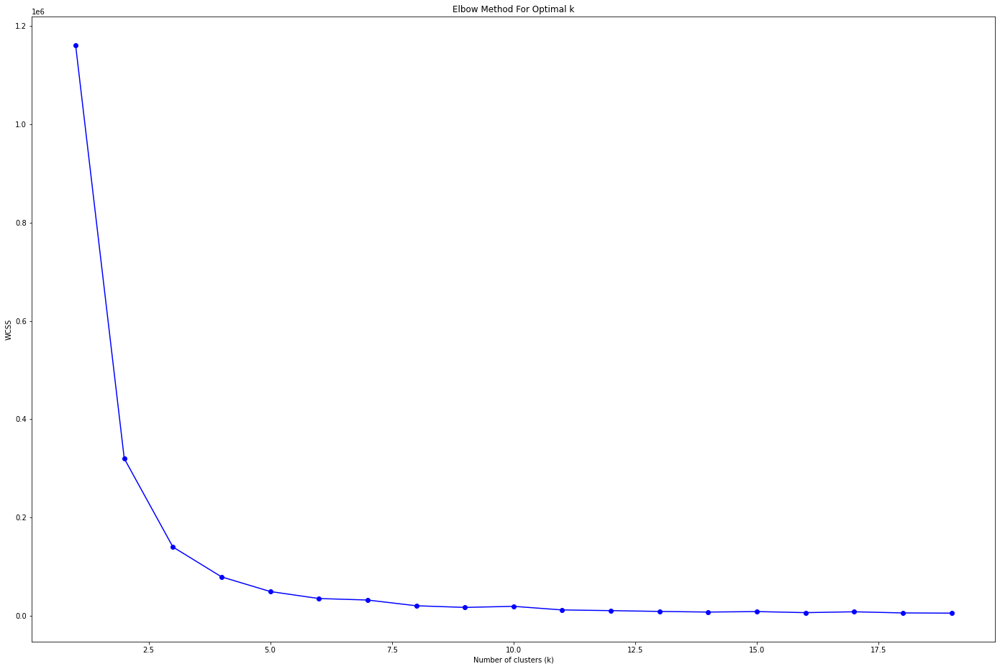

In [101]:
import random
import matplotlib.pyplot as plt
from multiprocessing import Pool
import datetime as dt

def euclidean_distance(point1, point2):
    return sum((p1 - p2) ** 2 for p1, p2 in zip(point1, point2)) ** 0.5

def calculate_centroid(cluster):
    length = len(cluster)
    return tuple(sum(values) / length for values in zip(*cluster))

def assign_cluster(args):
    point, centroids = args
    distances = [euclidean_distance(point, centroid) for centroid in centroids]
    return distances.index(min(distances))

def calculate_distance_squared(args):
    point, centroid = args
    return euclidean_distance(point, centroid) ** 2

def calculate_wcss(clusters, centroids):
    return sum(sum(euclidean_distance(point, centroid) ** 2 for point in cluster) for cluster, centroid in zip(clusters, centroids))

def k_means(data, k, max_iterations=500, tolerance=0.0001):
    centroids = [tuple(random.choice(data)) for _ in range(k)]
    clusters = [[] for _ in range(k)]
    labels = [-1] * len(data)  # Inicializar las etiquetas de los clusters

    for iteration in range(max_iterations):
        for cluster in clusters:
            cluster.clear()

        for index, point in enumerate(data):
            distances = [euclidean_distance(point, centroid) for centroid in centroids]
            closest_centroid = distances.index(min(distances))
            clusters[closest_centroid].append(point)
            labels[index] = closest_centroid  # Asignar la etiqueta del cluster al punto

        new_centroids = [calculate_centroid(cluster) if cluster else centroids[i] for i, cluster in enumerate(clusters)]

        if all(euclidean_distance(centroids[i], new_centroids[i]) < tolerance for i in range(k)):
            break

        centroids = new_centroids

    wcss = calculate_wcss(clusters, centroids)
    return clusters, centroids, wcss, labels  # Devolver también las etiquetas

def k_means_and_wcss(k):
    print(f"k={k}")
    _, _, wcss_value,_ = k_means(points, k)
    return wcss_value

# Suponemos que 'incidencias_del' es tu diccionario de datos
points = list(zip(incidencias_del['COORD X'], incidencias_del['COORD Y']))
min_date = min(incidencias_del['fechas_horas'])
time_values = [dt.hour + dt.minute / 60.0 for dt in incidencias_del['fechas_horas']]
points = list(zip(incidencias_del['COORD X'], incidencias_del['COORD Y'], time_values))

# Evaluar WCSS para diferentes números de clusters usando multiprocessing
ks = range(1, 20)  # Evaluar desde 1 hasta 100 clusters

if __name__ == '__main__':
    with Pool() as pool:
        wcss = pool.map(k_means_and_wcss, ks)

    # Graficar el método del codo
    plt.figure(figsize=(24, 16))
    plt.plot(list(ks), wcss, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('WCSS')
    plt.title('Elbow Method For Optimal k')
    plt.show()


[(-99.1273020518037, 19.38087471159045, 19.110475960765424), (-99.13048427210687, 19.385176110916518, 15.651813301911488), (-99.12757305939105, 19.384713940682662, 17.450056415215975), (-99.12813883826001, 19.377220744263948, 22.68578052550232), (-99.12905727969287, 19.38462415693386, 13.700226757369613), (-99.1304147310514, 19.39170961354713, 8.746374986884884), (-99.1278715326935, 19.385433936266026, 5.58893171806167), (-99.12972497886517, 19.38286475837912, 1.6904745166959587), (-99.12984506912846, 19.387406548093985, 11.52464249748238), (-99.12699003574478, 19.377135618359443, 20.738251536938638)]
[8, 9, 5, 8, 8, 2, 2, 2, 8, 4, 1, 3, 4, 3, 1, 5, 8, 3, 7, 9, 1, 7, 4, 8, 8, 6, 4, 9, 1, 8, 7, 8, 8, 1, 8, 7, 8, 6, 5, 0, 1, 8, 8, 4, 8, 8, 7, 3, 1, 8, 4, 7, 3, 8, 1, 2, 9, 7, 7, 8, 9, 8, 5, 5, 8, 8, 1, 0, 2, 5, 2, 8, 9, 8, 8, 8, 1, 8, 4, 7, 8, 0, 0, 2, 4, 9, 8, 6, 7, 5, 2, 4, 6, 4, 8, 1, 2, 9, 8, 3, 2, 8, 5, 4, 3, 8, 8, 4, 9, 5, 9, 1, 5, 8, 8, 8, 8, 4, 7, 8, 8, 8, 4, 5, 8, 3, 1, 7, 9, 7, 

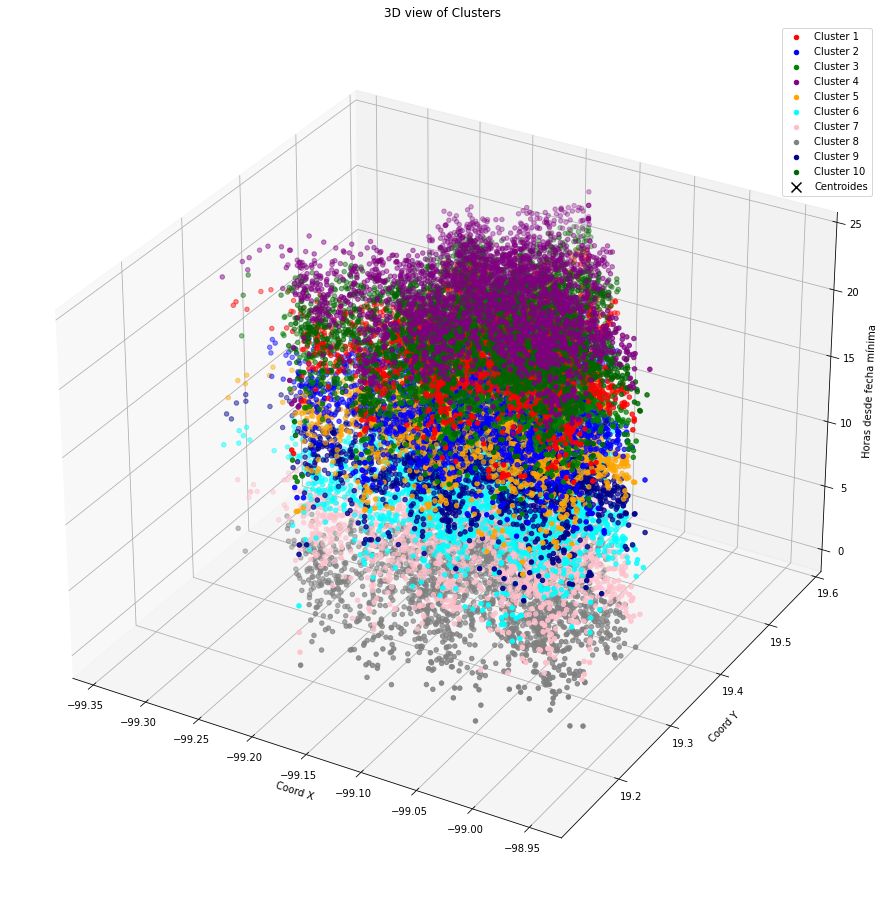

In [102]:
# Aplicar K-Means
clusters, centroids, wcss, labels = k_means(points, k=10)
print(centroids)
print(labels)
print(len(labels))
incidencias_del['Cluster'] = labels

# Crear figura para la gráfica 3D
fig = plt.figure(figsize=(24, 16))  # Ajusta aquí el tamaño como desees
ax = fig.add_subplot(111, projection='3d')

colores = ['red', 'blue', 'green', 'purple', 'orange', 'cyan', 'pink', 'gray', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
for i, cluster in enumerate(clusters):
    x, y, z = zip(*cluster)
    ax.scatter(x, y, z, c=colores[i], marker='o', label=f'Cluster {i+1}')

# Plotear los centroides
centroids_x, centroids_y, centroids_z = zip(*centroids)
ax.scatter(centroids_x, centroids_y, centroids_z, c='black', marker='x', s=100, label='Centroides')

ax.set_xlabel('Coord X')
ax.set_ylabel('Coord Y')
ax.set_zlabel('Horas desde fecha mínima')
ax.legend()
plt.title('3D view of Clusters')
plt.show()

In [103]:
# Determinar el centro del mapa (podría ser el centroide de todos los puntos, o un punto central conocido)
map_center_lat = sum([float(coord) for coord in incidencias_del['COORD Y']]) / len(incidencias_del['COORD Y'])
map_center_lon = sum([float(coord) for coord in incidencias_del['COORD X']]) / len(incidencias_del['COORD X'])
mymap = folium.Map(location=[map_center_lat, map_center_lon], zoom_start=12)

# Colores para los diferentes clusters
colores =  ['red', 'blue', 'green', 'purple', 'orange', 'cyan', 'pink', 'gray', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']

# Añadir marcadores al mapa
for cluster_id, cluster in enumerate(clusters):
    for point in cluster:
        folium.CircleMarker(
            location=(point[1], point[0]),  # Asegúrate de que los puntos están en formato (latitud, longitud)
            radius=5,  # Tamaño del marcador
            color=colores[cluster_id % len(colores)],  # Color del cluster
            fill=True,
            fill_color=colores[cluster_id % len(colores)],
            fill_opacity=0.7
        ).add_to(mymap)

# Guardar el mapa en un archivo HTML
mymap.save("map.html")
mymap


In [104]:
# Extraer la hora del día y el día de la semana

num_dias_registrados = 425

horas_del_dia = [fecha.hour for fecha in incidencias_del['fechas_horas']]

# Inicializar diccionarios para contar delitos y horas en cada cluster
delitos_por_tipo = {i: {} for i in set(incidencias_del['Cluster'])}
horas_por_cluster = {i: [] for i in set(incidencias_del['Cluster'])}
total_delitos_por_cluster = {i: 0 for i in set(incidencias_del['Cluster'])}  # Diccionario para el total de delitos por cluster

# Contar delitos por tipo y acumular horas en cada cluster
for i in range(len(incidencias_del['Cluster'])):
    cluster = incidencias_del['Cluster'][i]
    tipo_delito = incidencias_del['DELITO'][i]
    hora = horas_del_dia[i]
    
    horas_por_cluster[cluster].append(hora)
    
    if tipo_delito not in delitos_por_tipo[cluster]:
        delitos_por_tipo[cluster][tipo_delito] = 0
    delitos_por_tipo[cluster][tipo_delito] += 1
    total_delitos_por_cluster[cluster] += 1  # Sumar al total de delitos en el cluster

# Analizar y presentar resultados
print("Análisis Condensado de Clusters:")
for cluster, delitos in delitos_por_tipo.items():
    # Calcular el rango horario predominante en el cluster
    min_hora = min(horas_por_cluster[cluster])
    max_hora = max(horas_por_cluster[cluster])
    total_delitos = total_delitos_por_cluster[cluster]  # Total de delitos para el cluster
    
    # Ordenar delitos por frecuencia
    delitos_ordenados = sorted(delitos.items(), key=lambda item: item[1], reverse=True)
    max_delitos = delitos_ordenados[:3]  # Los dos tipos de delitos más comunes
    min_delitos = delitos_ordenados[-3:]  # Los dos tipos de delitos menos comunes si hay suficientes tipos

    print(f"\nCluster {cluster} (Hora predominante: {min_hora}-{max_hora}h, Total de delitos: {total_delitos}):")
    print("  Delitos más comunes:")
    for delito, count in max_delitos:
        print(f"    {delito}: {count} veces -> {count/num_dias_registrados} al día")
    
    print("  Delitos menos comunes:")
    for delito, count in min_delitos:
        print(f"    {delito}: {count} veces -> {count/num_dias_registrados} al día")


Análisis Condensado de Clusters:

Cluster 0 (Hora predominante: 18-19h, Total de delitos: 2073):
  Delitos más comunes:
    ROBO A TRANSEUNTE EN VÍA PÚBLICA CON Y SIN VIOLENCIA: 729 veces -> 1.7152941176470589 al día
    ROBO DE VEHÍCULO CON Y SIN VIOLENCIA: 565 veces -> 1.3294117647058823 al día
    ROBO A NEGOCIO CON VIOLENCIA: 279 veces -> 0.6564705882352941 al día
  Delitos menos comunes:
    ROBO A CASA HABITACIÓN CON VIOLENCIA: 30 veces -> 0.07058823529411765 al día
    ROBO A PASAJERO A BORDO DE TAXI CON VIOLENCIA: 11 veces -> 0.02588235294117647 al día
    ROBO A CUENTAHABIENTE SALIENDO DEL CAJERO CON VIOLENCIA: 7 veces -> 0.01647058823529412 al día

Cluster 1 (Hora predominante: 14-16h, Total de delitos: 2546):
  Delitos más comunes:
    ROBO A TRANSEUNTE EN VÍA PÚBLICA CON Y SIN VIOLENCIA: 1093 veces -> 2.571764705882353 al día
    ROBO DE VEHÍCULO CON Y SIN VIOLENCIA: 527 veces -> 1.24 al día
    VIOLACIÓN: 270 veces -> 0.6352941176470588 al día
  Delitos menos comunes:
    

## Análisis de Patrones de Criminalidad por Cluster

### Resumen de Hallazgos
El análisis revela diferencias significativas en los patrones de criminalidad entre los clusters, con variaciones notables en los tipos de delitos más comunes y en los rangos horarios de mayor actividad delictiva. Esto sugiere áreas específicas de enfoque para intervenciones de seguridad y prevención.

### Detalles del Análisis por Cluster

#### Cluster 6
- **Horario de Actividad Predominante**: Noche tardía (0-3h)
- **Delitos más frecuentes**: Robo a transeunte (2.09/día).
- **Implicaciones**: La actividad nocturna tardía sugiere problemas en áreas con bares o entretenimiento nocturno, donde la vigilancia y medidas preventivas podrían reducir significativamente la criminalidad.

#### Cluster 4
- **Horario de Actividad Predominante**: Madrugada (3-6h)
- **Delitos más frecuentes**: Robo a transeunte (1.73/día).
- **Implicaciones**: Este horario inusual de actividad delictiva alta podría estar relacionado con zonas de vida nocturna y requeriría un enfoque específico en bares y clubes.

#### Cluster 3
- **Horario de Actividad Predominante**: Mañana temprano (6-9h)
- **Delitos más frecuentes**: Robo a transeunte (2.16/día).
- **Implicaciones**: El alto índice de robos en las primeras horas sugiere que medidas como mejor iluminación y patrullaje podrían ser efectivas.

#### Cluster 0
- **Horario de Actividad Predominante**: Mañana (9-11h)
- **Delitos más frecuentes**: Robo a transeunte (2.14/día), seguido de robo de vehículo (1.12/día).
- **Implicaciones**: El aumento matutino en robos sugiere la necesidad de incrementar la vigilancia durante estas horas, especialmente en rutas de tránsito público y áreas comerciales.

#### Cluster 7
- **Horario de Actividad Predominante**: Mediodía (11-13h)
- **Delitos más frecuentes**: Robo a transeunte (2.68/día).
- **Implicaciones**: Este aumento al mediodía podría indicar áreas con alta actividad durante el almuerzo, requiriendo atención en zonas de restaurantes y parques.

#### Cluster 9
- **Horario de Actividad Predominante**: Temprano en la tarde (13-15h)
- **Delitos más frecuentes**: Robo a transeunte (2.56/día).
- **Implicaciones**: Actividad delictiva concentrada después del mediodía, posiblemente en áreas comerciales y educativas, lo que justificaría patrullas aumentadas y campañas de concientización.

#### Cluster 1
- **Horario de Actividad Predominante**: Tarde (15-16h)
- **Delitos más frecuentes**: Robo a transeunte (2.20/día).
- **Implicaciones**: La concentración de delitos en la tarde puede estar relacionada con la alta actividad en áreas comerciales después del horario escolar o laboral, sugiriendo patrullas y presencia policial reforzada durante estas horas.


#### Cluster 5
- **Horario de Actividad Predominante**: Tarde (16-18h)
- **Delitos más frecuentes**: Robo a transeunte (2.11/día).
- **Implicaciones**: Similar al Cluster 1, este patrón puede estar asociado con zonas comerciales y grandes flujos de personas en horas pico.

#### Cluster 2
- **Horario de Actividad Predominante**: Noche (18-21h)
- **Delitos más frecuentes**: Robo a transeunte (3.11/día), destacándose como el cluster con la mayor frecuencia diaria.
- **Implicaciones**: Este patrón indica un riesgo significativo durante las primeras horas de la noche, posiblemente vinculado a la salida de personas de sus trabajos y la menor iluminación en ciertas áreas.

#### Cluster 8
- **Horario de Actividad Predominante**: Noche (21-23h)
- **Delitos más frecuentes**: Robo de vehículo (2.53/día).
- **Implicaciones**: La prevalencia de robo de vehículos durante la noche sugiere la necesidad de seguridad reforzada en estacionamientos y áreas residenciales.


### Conclusión
La identificación de patrones específicos de criminalidad por horarios y tipos de delito en cada cluster proporciona una base sólida para dirigir los recursos de seguridad pública de manera más efectiva. La adaptación de las estrategias de prevención y respuesta a estos patrones puede ayudar a mitigar los riesgos y mejorar la seguridad en las comunidades afectadas.


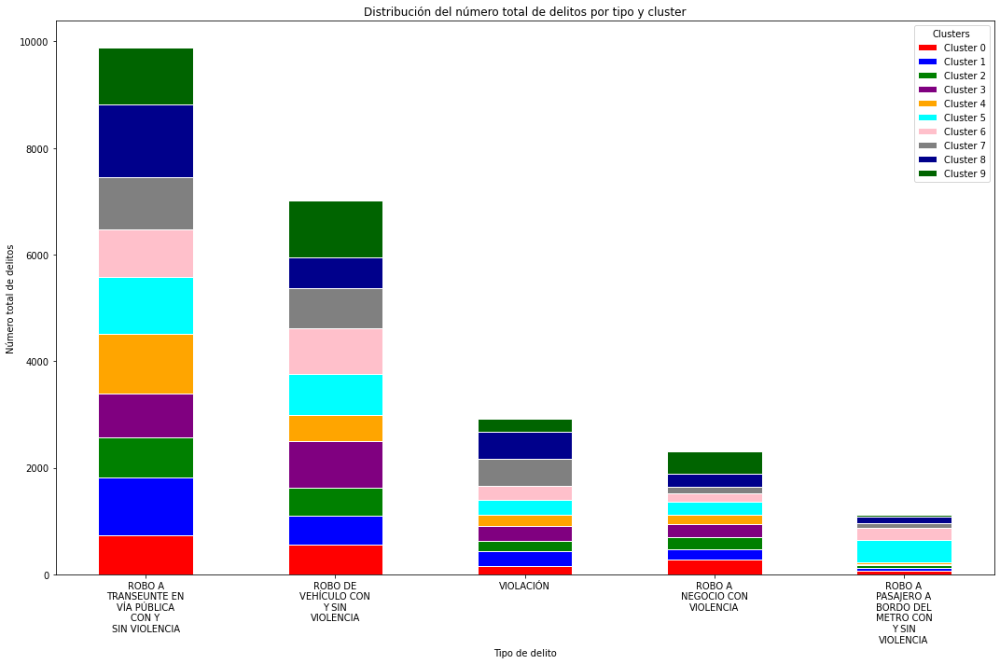

In [106]:
import matplotlib.pyplot as plt

# Obtener la lista única de delitos
tipos_de_delitos = list(set(incidencias_del["DELITO"]))

# Obtener la lista única de clusters
clusters = list(set(incidencias_del["Cluster"]))

# Colores específicos proporcionados
colores = ['red', 'blue', 'green', 'purple', 'orange', 'cyan', 'pink', 'gray', 'darkblue', 'darkgreen', 
           'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']

# Conteo de delitos y sus tipos
conteo_delitos = {}
for delito in incidencias_del["DELITO"]:
    if delito in conteo_delitos:
        conteo_delitos[delito] += 1
    else:
        conteo_delitos[delito] = 1

# Ordenar los delitos de más común a menos común y tomar los 5 primeros
delitos_ordenados = sorted(conteo_delitos.items(), key=lambda item: item[1], reverse=True)
cinco_delitos_mas_frecuentes = [delito[0] for delito in delitos_ordenados[:5]]

# Preparar los datos para los cinco delitos más frecuentes
conteos_por_delito = {delito: [0] * len(clusters) for delito in cinco_delitos_mas_frecuentes}

# Llenar los conteos de delitos por tipo y por cluster para los cinco delitos más frecuentes
for i, delito in enumerate(incidencias_del["DELITO"]):
    if delito in cinco_delitos_mas_frecuentes:
        cluster = incidencias_del["Cluster"][i]
        conteos_por_delito[delito][cluster] += 1

# Crear las barras apiladas para los cinco delitos más frecuentes
fig, ax = plt.subplots(figsize=(15, 10))

# La base para cada barra apilada
base = [0] * len(cinco_delitos_mas_frecuentes)

# Iterar sobre cada cluster para construir la gráfica de barras apiladas
clusters = list(set(incidencias_del["Cluster"]))
for idx, cluster in enumerate(clusters):
    conteos = [conteos_por_delito[delito][idx] for delito in cinco_delitos_mas_frecuentes]
    ax.bar(cinco_delitos_mas_frecuentes, conteos, bottom=base, color=colores[idx % len(colores)], edgecolor='white', width=0.5, label=f'Cluster {cluster}')
    base = [i + j for i, j in zip(base, conteos)]

# Configurar las etiquetas y título
ax.set_xlabel('Tipo de delito')
ax.set_ylabel('Número total de delitos')
ax.set_title('Distribución del número total de delitos por tipo y cluster')
ax.legend(title='Clusters')

# Función para dividir el texto cada dos palabras
def dividir_etiquetas(texto):
    palabras = texto.split()
    return '\n'.join(' '.join(palabras[i:i+2]) for i in range(0, len(palabras), 2))

# Ajustar las etiquetas del eje X
etiquetas_con_saltos = [dividir_etiquetas(delito) for delito in cinco_delitos_mas_frecuentes]
plt.xticks(range(len(cinco_delitos_mas_frecuentes)), etiquetas_con_saltos, ha='center')

# Mostrar la gráfica
plt.tight_layout()
plt.show()
